# Notebook for model training

### Training Flow

Load Training Data:
- Load set of input data and label files
- Prefilter positive set only to rule out heavily-masked patches
- Create train/test set
- Define augmentation parameters

Train Model:
- Define model architecture
- Compile model
- Train and evaluate model
- Save model

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from datetime import date
from datetime import datetime
import time
import os
import pickle
import sys

import pandas as pd
import io
from contextlib import redirect_stdout
import re
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from tensorflow import keras
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.models import Model

from keras.layers import Input, Dense, Flatten, Dropout, Conv2D
from keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tqdm.notebook import tqdm

parent_dir = os.path.split(os.getcwd())[0]
if parent_dir not in sys.path:
    sys.path.insert(0, parent_dir)

from scripts import dl_utils
from scripts import viz_tools
from scripts import models

import gc
from tensorflow.keras import backend as K

2024-09-08 08:50:47.388135: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-09-08 08:50:47.527404: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-09-08 08:50:47.527426: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-09-08 08:50:47.551133: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-09-08 08:50:47.600953: I tensorflow/core/platform/cpu_feature_guar

## Open Data

In [3]:
resolution = 48

data_file_names = [ 
                    'amazonas_2020_thresh_0.5_2_negatives',
                    'amazonas_2020_thresh_0.8_sumbsample_3_positives',
                    'MinesPos2018-2020Sentinel_points',
                    'bolivar_2020_thresh_0.8_sumbsample_5_positives',
                    'full_amazon_v9_negatives',
                    'v2.4_amazon_positives',
                    'v2.6_amazon_thresh_0.8_negatives',
                    'v2.0_bolivar_negatives',
                    'riverbank_negatives',
                    'v2.1_bolivar_positives',
                    'bolivar_2020_thresh_0.8_1_negatives', 
                    'v2.1.1_bolivar_negatives',
                    'v2.1_bolivar_positives_v2',
              ]

#start_dates = ['2020-01-01', '2021-01-01', '2022-01-01']
#end_dates = ['2021-01-01', '2022-01-01', '2023-01-01']
start_dates = ['2019-01-01']
end_dates = ['2020-01-01']
dates = [f'{sd}_{ed}' for sd,ed in zip(start_dates, end_dates)]
data_files = [f'{fn}_{sd}_{ed}_patch_arrays.pkl' for fn in data_file_names for sd, ed in zip(start_dates, end_dates)]
label_files = [f.split('s.pkl')[0] + '_labels.pkl' for f in data_files]

data_files += [
    "amazonas_2020_thresh_0.5_2_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "amazonas_2020_thresh_0.8_sumbsample_3_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "MinesPos2018-2020Sentinel_points_2019-01-01_2020-01-01_patch_arrays.pkl",
    "bolivar_2020_thresh_0.8_sumbsample_5_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "full_amazon_v9_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.4_amazon_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.6_amazon_thresh_0.8_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.0_bolivar_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "riverbank_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.1_bolivar_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "bolivar_2020_thresh_0.8_1_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.1.1_bolivar_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.1_bolivar_positives_v2_2019-01-01_2020-01-01_patch_arrays.pkl"
    ]

label_files += [
    "amazonas_2020_thresh_0.5_2_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "amazonas_2020_thresh_0.8_sumbsample_3_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "MinesPos2018-2020Sentinel_points_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "bolivar_2020_thresh_0.8_sumbsample_5_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "full_amazon_v9_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.4_amazon_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.6_amazon_thresh_0.8_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.0_bolivar_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "riverbank_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.1_bolivar_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "bolivar_2020_thresh_0.8_1_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.1.1_bolivar_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.1_bolivar_positives_v2_2019-01-01_2020-01-01_patch_array_labels.pkl"
 
]

patches = []
labels = []

data_dir = os.path.join('..', 'data', 'training_data', f"{resolution}_px")

for data, label in tqdm(zip(data_files, label_files), total=len(data_files)):
    with open(os.path.join(data_dir, data), 'rb') as f:
        data = pickle.load(f)
        for elem in data:
            #patch = dl_utils.pad_patch(elem, resolution)
            patches.append(elem)
    with open(os.path.join(data_dir, label), 'rb') as f:
        label = pickle.load(f)
        labels = np.concatenate((labels, label))

patches = np.array(patches)
negative_patches = patches[labels == 0]
positive_patches = patches[labels == 1]

print(len(patches), "samples loaded")
print(sum(labels == 1), "positive samples")
print(sum(labels == 0), "negative samples")

  0%|          | 0/26 [00:00<?, ?it/s]

4516 samples loaded
1560 positive samples
2956 negative samples


  0%|          | 0/64 [00:00<?, ?it/s]

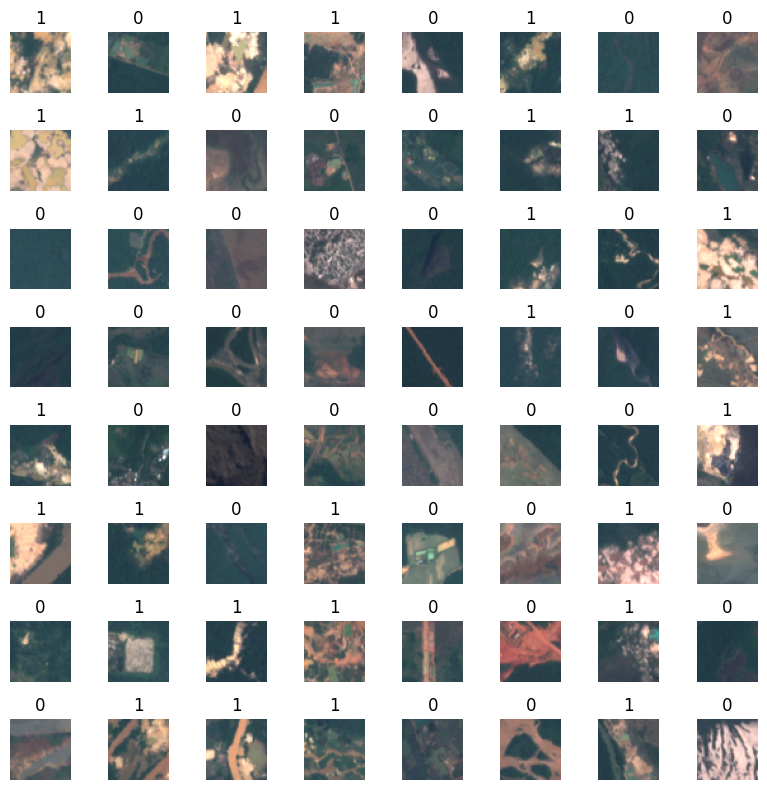

In [4]:
num_samples = 64
indices = np.random.randint(0, len(patches), num_samples)
viz_tools.plot_image_grid(patches[indices], labels=[int(label) for label in labels[indices]])

In [5]:
def filter_black(data, mask_limit=0.1, return_rejects=False):
    masked_fraction = np.array([np.sum(np.mean(patch, axis=-1) < 10) / np.size(np.mean(patch, axis=-1)) for patch in data])
    filtered_data = data[masked_fraction < mask_limit]
    print(f"{len(filtered_data) / len(data) :.1%} of data below brightness limit")
    if return_rejects:
        rejected_data = data[masked_fraction >= mask_limit]
        return filtered_data, rejected_data
    else:
        return filtered_data

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.7546666666666666].


100.0% of data below brightness limit


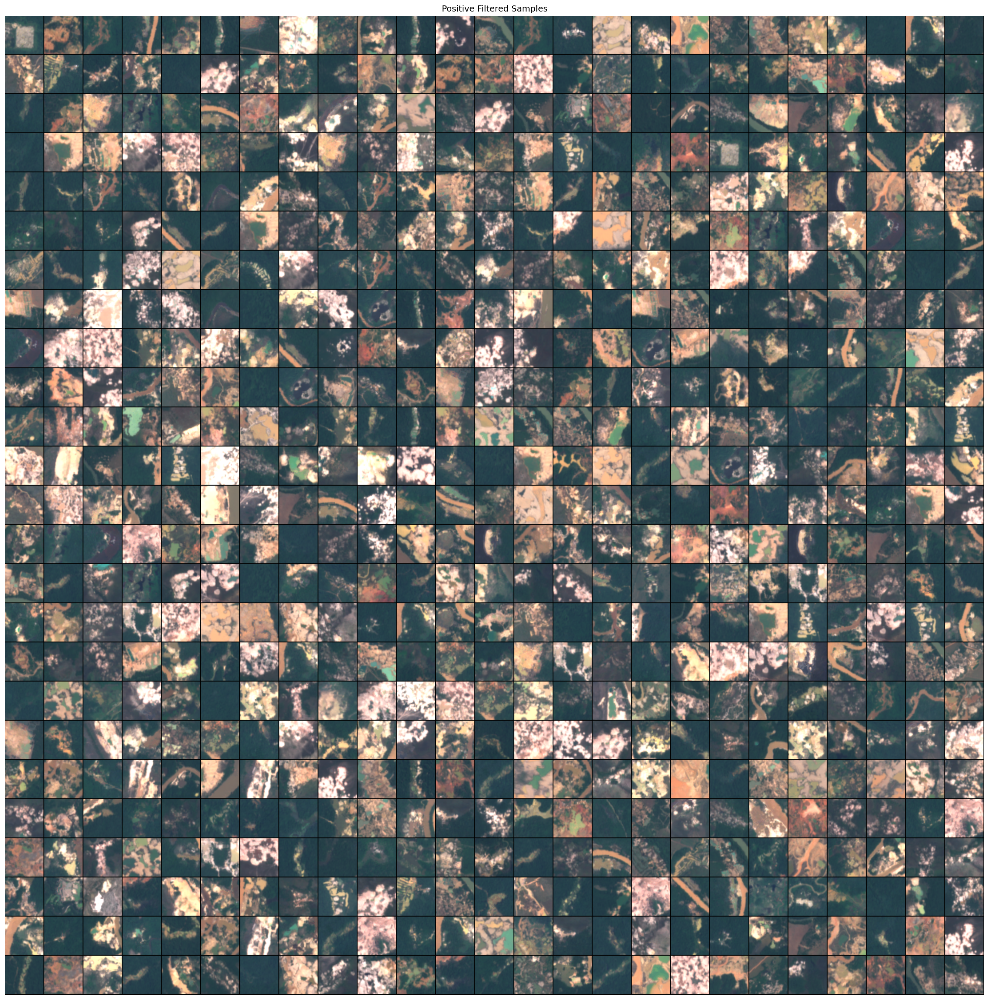

In [6]:
# Filter positive pixels that are masked beyond a threshold. Don't want to give positive examples of cloud-masked patches
filtered_positives, positive_rejects = filter_black(positive_patches, mask_limit = 0.1, return_rejects=True)
if len(positive_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(positive_rejects), num_samples)
    viz_tools.plot_numpy_grid(positive_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Positive Masked Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_positives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_positives[indices,:,:,3:0:-1] / 3000)
plt.title('Positive Filtered Samples')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..3.9053333333333335].


100.0% of data below brightness limit


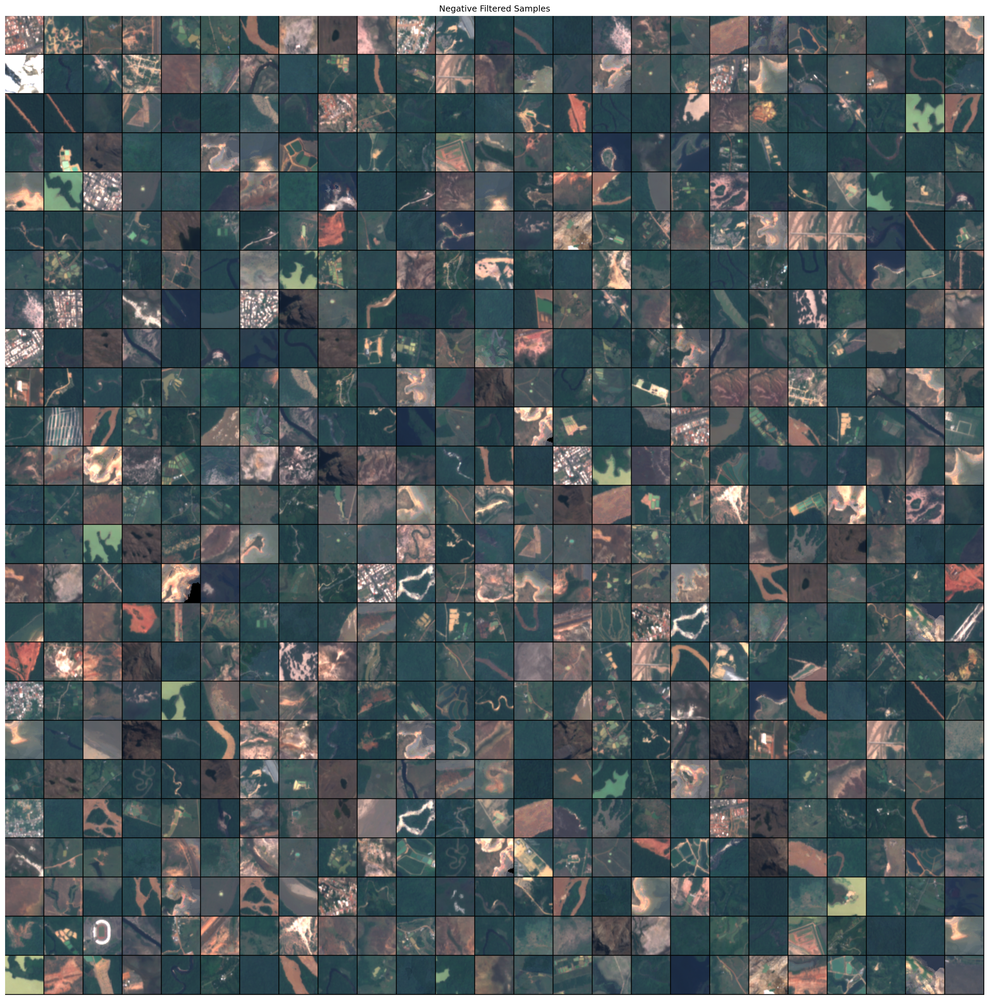

In [7]:
filtered_negatives, negative_rejects = filter_black(negative_patches, mask_limit = 0.6, return_rejects=True)
if len(negative_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(negative_rejects), num_samples)
    viz_tools.plot_numpy_grid(negative_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Negative Mask Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_negatives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_negatives[indices,:,:,3:0:-1] / 3000)
plt.title('Negative Filtered Samples')
plt.show()

## Prepare Data for Training

In [8]:
#for RGBIR, x = normalize(np.copy(images[:,:,:,[1,2,3,8]]))
x = np.concatenate((filtered_negatives, filtered_positives))
y = np.concatenate((np.zeros(len(filtered_negatives)), np.ones(len(filtered_positives))))
x, y = shuffle(x, y, random_state=33)

## Data Augmentation
Augmentation is important to help the model train. These are parameters that generally worked, but there is certainly room for improvement.

Plot a set of images to give an example of augmented images

/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (4516, 48, 48, 12) (12 channels).
  warnings.warn(


  0%|          | 0/64 [00:00<?, ?it/s]

<Figure size 1800x1800 with 0 Axes>

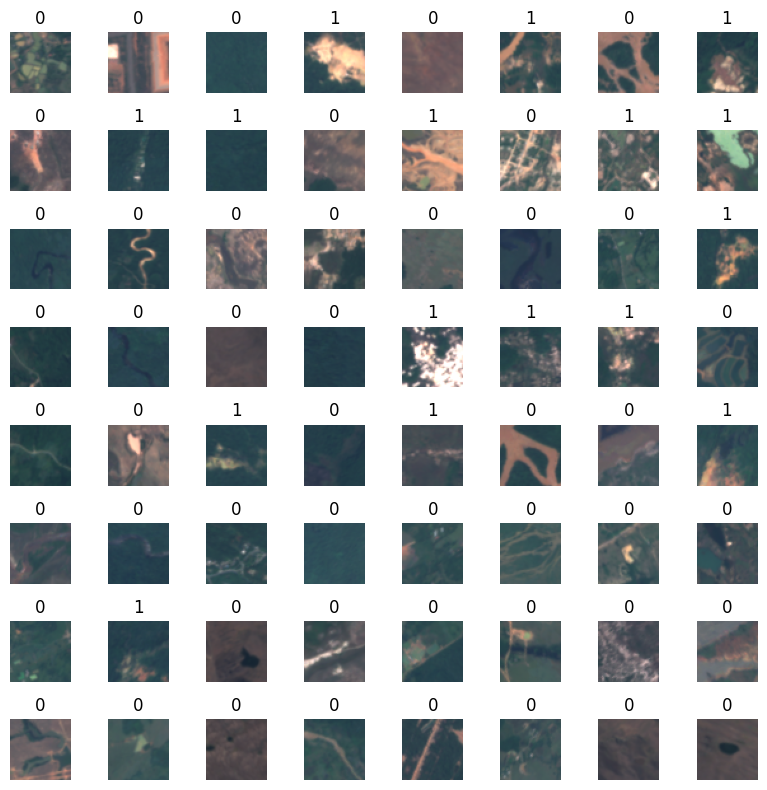

In [9]:
augmentation_parameters = {
    'featurewise_center': False,
    'rotation_range': 360,
    'width_shift_range': [0.9, 1.1],
    'height_shift_range': [0.9, 1.1],
    'shear_range': 10,
    'zoom_range': [0.9, 1.1],
    'vertical_flip': True,
    'horizontal_flip': True,
    # Fill options: "constant", "nearest", "reflect" or "wrap"
    'fill_mode': 'reflect'
}

datagen = ImageDataGenerator(**augmentation_parameters)


plt.figure(figsize=(12,12), facecolor=(1,1,1), dpi=150)
aug_img, aug_labels = datagen.flow(x, y, batch_size=64).next()
viz_tools.plot_image_grid(aug_img, labels=[int(l) for l in aug_labels], norm=True);


In [10]:
x_norm = np.clip(np.array(x.astype("float32") / 10000), 0, 1)

Partimos el 10% del dataset total para test

In [11]:
dataset_size = len(y)
test_partition = int(dataset_size*0.1)

In [12]:
num_positive_samples_train = sum(y[test_partition:]==1)
num_negative_samples_train = sum(y[test_partition:]==0)

print(f"Número de clases positivas en el dataset de training es de {num_positive_samples_train}, número de clases negativas {num_negative_samples_train}")

Número de clases positivas en el dataset de training es de 1410, número de clases negativas 2655


Eliminamos estos samples del dataset de validacion

In [13]:
test_partition_x = x_norm[:test_partition]
test_partition_y = y[:test_partition]

x_norm = x_norm[test_partition:]
y = y[test_partition:]

# Entrenamiento de la arquitectura original con los parámetros originales

##  Hiperparámetros ejecuciones originales

In [14]:
hiper_params_original_test = {"class_weight" : {0: 1, 1: 1},
                              "batch_size" : 32,
                              "epochs" : 160,
                              "test_size" : 0.3
                           }   

### Entrenamiento
- Entrenamos el modelo original para 5 semillas distintas. Se elige el mejor modelo para poder compararlo con los demás.
- Total de modelos construidos = 5
- Tiempo total 2s * 160 epocas * 5 modelos = 27 mins

In [15]:
%%time

# Descripcion de esta prueba
desc_test = "modelo_y_parametros_originales"
hiperparametros = [hiper_params_original_test]

# Inicializamos para dar nombre a todos los outputs que se escriban
hora_exec = datetime.now().strftime('%Y-%m-%d_%H-%M')

# Creamos el nombre del directorio para guardar los modelos finales
path_prueba_actual = f"../notebooks/best_models/{desc_test}_{hora_exec}/"
os.makedirs(path_prueba_actual, exist_ok=True)

# Inicializamos las variables dónde almacenaremos los resultados de cada uno de los modelos generados
df_scratch = pd.DataFrame()

#Eliminamos los csvs generados en ejecuciones anteriores
dl_utils.limpia_directorios("aux_path")

# Recorremos la lista de configuraciones distinta generada anteriormente
for id_hiperparams,hiperparams in enumerate(hiperparametros):
    for semilla in range(0,5):  

        # Limpiamos la carpeta donde se guardan los modelos
        dl_utils.limpia_directorios("weigths")

        # Definimos hiperparámetros asociados a la ejecución actual
        batch_size = hiperparams["batch_size"]
        epochs = hiperparams["epochs"]
     
        # Dividimos el conjunto de imágenes en train y test
        seed = np.random.randint(0, 2000,1)[0]
        hiperparams["semilla"] = seed
        keras.utils.set_random_seed(int(seed))
        x_train, x_test, y_train, y_test = train_test_split(x_norm, y, test_size=hiperparams["test_size"], random_state=123)

        # Definimos y compilamos los modelos
        scratch_original_model_and_params = models.scratch_original_model(x_train.shape[1:])

        start_time = time.time()
        # Modelo por defecto empleando los mismos parámetros que el original.
        scratch_original_model_and_params_results = scratch_original_model_and_params.fit(
            datagen.flow(x_train, y_train),
            batch_size=batch_size,
            epochs=epochs,
            validation_data=(x_test, y_test),
            verbose=1,
            shuffle=True,
            class_weight={0: 1, 1: 1},
        )
        training_time_scratch_original_model_and_params = time.time() - start_time

        # Evaluamos el modelo y lo comparamos con el mejor almacenado.  
        hora_actual = datetime.now().strftime('%Y-%m-%d_%H-%M')
        df_scratch,          save_df_scratch          = dl_utils.get_df_best_model(scratch_original_model_and_params,test_partition_x,test_partition_y,f"scratch_original_model_and_params_{desc_test}_",df_scratch,hora_actual)

        # Si el modelo actual es mejor que el almacenado, guardamos su información.      
        if save_df_scratch:
            best_scratch_original_model_and_params = scratch_original_model_and_params
            best_scratch_original_model_and_params_results = scratch_original_model_and_params_results
            best_scratch_original_model_and_params__hiperparams = [hiperparams,id_hiperparams+1,f'resultados_evaluacion_scratch_original_model_and_params_{desc_test}_{hora_actual}.csv',training_time_scratch_original_model_and_params]
        
        del scratch_original_model_and_params
        del scratch_original_model_and_params_results
        K.clear_session()
        gc.collect()        

# Guardamos el mejor modelo
dl_utils.save_models(best_scratch_original_model_and_params,best_scratch_original_model_and_params_results,best_scratch_original_model_and_params__hiperparams,hora_exec,f'scratch_original_model_and_params_{desc_test}',path_prueba_actual)

# Movemos los archivos asociados a los resultados
dl_utils.obtener_tablas_resultado(path_prueba_actual,[best_scratch_original_model_and_params__hiperparams[2]])

# Entrenamiento de las diferentes arquitecturas con nuevos parámetros

## Balanceo de clases para el entrenamiento

In [16]:
# dataset_len = len(y)
# class_0 = len(y[y==0])
# class_1 = len(y[y==1])

# class_0_weighted = 2 - len(y[y==0]) / len(y)
# class_1_weighted = 2 - len(y[y==1]) / len(y)

# # add a weighted loss
# class_weighted = {0: class_0_weighted, 1: class_1_weighted}
# print(f"\nEl número de valores para la clase no mina es de {class_0} y para la clase mina {class_1}")
# print(f"\nPonemos peso a cada clase para tenerlo en cuenta en el entrenamiento {class_weighted}")

## Clases no balanceadas

In [17]:
# # add a weighted loss
# class_weight = {0: 1, 1: 1}

## Diccionario con todos los hiperparámetros editables

### Hiperparámetros para pruebas con test size del 20%

In [18]:
#########################################################################################################
########################################## CLASES BALANCEADAS ###########################################
#########################################################################################################
                                                                                                        #
# reduce_lr en callbacks                                                                                #                            
hiper_params_test1_20 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],         #
                      "patience_early_stopping" : 7,                                                   #
                      "patience_reduce_lr" : 4,                                                         #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
                                                                                                        #
# SIN reduce_lr en callbacks                                                                            #
hiper_params_test2_20 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                      #
                      "patience_early_stopping" : 7,                                                   #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
#########################################################################################################

#########################################################################################################
####################################### CLASES NO BALANCEADAS ###########################################
#########################################################################################################
                                                                                                        #
# Reduce_lr en callbacks                                                                                #
hiper_params_test3_20 = {"class_weight" : {0: 1, 1: 1},                                                 #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],         #
                      "patience_early_stopping" : 7,                                                   #
                      "patience_reduce_lr" : 4,                                                         #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
#SIN Reduce_lr en callbacks                                                                             #
hiper_params_test4_20 = {"class_weight" : {0: 1, 1: 1},                                                 #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                      #
                      "patience_early_stopping" : 7,                                                   #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
#########################################################################################################

### Hiperparámetros para pruebas con test size del 30%

In [19]:
#########################################################################################################
###################################### CLASES BALANCEADAS ###############################################
#########################################################################################################
                                                                                                        #
# Reduce_lr en callbacks                                                                                #
hiper_params_test1_30 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 16,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],         #
                      "patience_early_stopping" : 7,                                                   #
                      "patience_reduce_lr" : 4,                                                         #
                      "test_size" : 0.3                                                                 #
                     }                                                                                  #         
                                                                                                        #
# SIN reduce_lr en callbacks                                                                            #   
hiper_params_test2_30 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 16,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                      #
                      "patience_early_stopping" : 7,                                                   #
                      "test_size" : 0.3                                                                 #
                     }                                                                                  #
#########################################################################################################

######################################################################################################
###################################### CLASES NO BALANCEADAS #########################################
######################################################################################################
                                                                                                     #
# Reduce_lr en callbacks                                                                             #  
hiper_params_test3_30 = {"class_weight" : {0: 1, 1: 1},                                              #
                      "batch_size" : 16,                                                             #
                      "epochs" : 160,                                                                #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],      #
                      "patience_early_stopping" : 7,                                                #
                      "patience_reduce_lr" : 4,                                                      #
                      "test_size" : 0.3                                                              #
                     }                                                                               #
                                                                                                     #
# SIN reduce_lr en callbacks                                                                         #      
hiper_params_test4_30 = {"class_weight" : {0: 1, 1: 1},                                              #
                      "batch_size" : 16,                                                             #
                      "epochs" : 160,                                                                #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                   #
                      "patience_early_stopping" : 7,                                                #
                      "test_size" : 0.3                                                              #
                     }                                                                               #
######################################################################################################

### Hiperparámetros para pruebas: aumento patience en early stopping y LR descendiente menos agresivo, split de 20%

In [20]:
#########################################################################################################
########################################## CLASES BALANCEADAS ###########################################
#########################################################################################################
                                                                                                        #
# reduce_lr en callbacks                                                                                #                            
hiper_params_test5_20 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],         #
                      "patience_early_stopping" : 14,                                                   #
                      "patience_reduce_lr" : 8,                                                        #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
                                                                                                        #
# SIN reduce_lr en callbacks                                                                            #
hiper_params_test6_20 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                      #
                      "patience_early_stopping" : 14,                                                   #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
#########################################################################################################

#########################################################################################################
####################################### CLASES NO BALANCEADAS ###########################################
#########################################################################################################
                                                                                                        #
# Reduce_lr en callbacks                                                                                #
hiper_params_test7_20 = {"class_weight" : {0: 1, 1: 1},                                                 #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],         #
                      "patience_early_stopping" : 14,                                                   #
                      "patience_reduce_lr" : 8,                                                        #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
#SIN Reduce_lr en callbacks                                                                             #
hiper_params_test8_20 = {"class_weight" : {0: 1, 1: 1},                                                 #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                      #
                      "patience_early_stopping" : 14,                                                   #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
#########################################################################################################

### Hiperparámetros para pruebas: aumento patience en early stopping y LR descendiente menos agresivo, split de 30%

In [21]:
#########################################################################################################
###################################### CLASES BALANCEADAS ###############################################
#########################################################################################################
                                                                                                        #
# Reduce_lr en callbacks                                                                                #
hiper_params_test5_30 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 16,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],         #
                      "patience_early_stopping" : 14,                                                   #
                      "patience_reduce_lr" : 8,                                                        #
                      "test_size" : 0.3                                                                 #
                     }                                                                                  #         
                                                                                                        #
# SIN reduce_lr en callbacks                                                                            #   
hiper_params_test6_30 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 16,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                      #
                      "patience_early_stopping" : 14,                                                   #
                      "test_size" : 0.3                                                                 #
                     }                                                                                  #
#########################################################################################################

######################################################################################################
###################################### CLASES NO BALANCEADAS #########################################
######################################################################################################
                                                                                                     #
# Reduce_lr en callbacks                                                                             #  
hiper_params_test7_30 = {"class_weight" : {0: 1, 1: 1},                                              #
                      "batch_size" : 16,                                                             #
                      "epochs" : 160,                                                                #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],      #
                      "patience_early_stopping" : 14,                                                #
                      "patience_reduce_lr" : 8,                                                     #
                      "test_size" : 0.3                                                              #
                     }                                                                               #
                                                                                                     #
# SIN reduce_lr en callbacks                                                                         #      
hiper_params_test8_30 = {"class_weight" : {0: 1, 1: 1},                                              #
                      "batch_size" : 16,                                                             #
                      "epochs" : 160,                                                                #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                   #
                      "patience_early_stopping" : 14,                                                #
                      "test_size" : 0.3                                                              #
                     }                                                                               #
######################################################################################################

### Generamos una lista con todos los hiperparámetros definidos

In [22]:
hiperparametros_20 = [hiper_params_test1_20, hiper_params_test2_20, hiper_params_test3_20, hiper_params_test4_20]
hiperparametros_30 = [hiper_params_test1_30, hiper_params_test2_30, hiper_params_test3_30, hiper_params_test4_30]

In [23]:
hiperparametros_20_modified = [hiper_params_test5_20, hiper_params_test6_20, hiper_params_test7_20, hiper_params_test8_20]
hiperparametros_30_modified = [hiper_params_test5_30, hiper_params_test6_30, hiper_params_test7_30, hiper_params_test8_30]

## Realizamos el entrenamiento

- Total de modelos construidos = 4 pruebas * 4 hiperparámetros/prueba * 3 semillas * 4 arquitecturas distintas = 192 modelos, 48 para cada una de las arquitecturas
- Tiempo total de entrenamiento = 192 modelos construidos * 110 (épocas de media) * 4s/época =~ 12 horas

In [24]:
tests = [
    ["split_20",hiperparametros_20],
    ["split_30",hiperparametros_30],
    ["split_20_modified",hiperparametros_20_modified],
    ["split_30_modified",hiperparametros_30_modified]
]

In [25]:
%%time

for test in tests:

    # Descripcion de esta prueba
    desc_test = test[0]
    hiperparametros = test[1]
    
    # Inicializamos para dar nombre a todos los outputs que se escriban
    hora_exec = datetime.now().strftime('%Y-%m-%d_%H-%M')
    
    # Creamos el nombre del directorio para guardar los modelos finales
    path_prueba_actual = f"../notebooks/best_models/{desc_test}_{hora_exec}/"
    os.makedirs(path_prueba_actual, exist_ok=True)
    
    # Inicializamos las variables dónde almacenaremos los resultados de cada uno de los modelos generados
    df_scratch = pd.DataFrame()
    df_scratch_modified = pd.DataFrame()
    df_vgg = pd.DataFrame()
    df_mobile_net = pd.DataFrame()
    
    #Eliminamos los csvs generados en ejecuciones anteriores
    dl_utils.limpia_directorios("aux_path")
    
    # Recorremos la lista de configuraciones distinta generada anteriormente
    for id_hiperparams,hiperparams in enumerate(hiperparametros):
        for semilla in range(0,3):  
    
            # Limpiamos la carpeta donde se guardan los modelos
            dl_utils.limpia_directorios("weigths")
    
            # Definimos hiperparámetros asociados a la ejecución actual
            batch_size = hiperparams["batch_size"]
            epochs = hiperparams["epochs"]
         
            # Dividimos el conjunto de imágenes en train y test
            seed = np.random.randint(0, 2000,1)[0]
            hiperparams["semilla"] = seed
            keras.utils.set_random_seed(int(seed))
            x_train, x_test, y_train, y_test = train_test_split(x_norm, y, test_size=hiperparams["test_size"], random_state=123)
    
            # Generamos los datagen de imágenes, empleamos las mismas imágenes en todos los modelos
            datagen.fit(x_train)
            train_generator = datagen.flow(x_train, y_train, batch_size=batch_size, shuffle=False)
            test_generator = datagen.flow(x_test, y_test, batch_size=batch_size, shuffle=False)
            
            # Definimos y compilamos los modelos
            scratch_original_model = models.scratch_original_model(x_train.shape[1:])
            scratch_modified_model = models.scratch_modified_model(x_train.shape[1:])
            vgg16 = models.vgg_16_model(x_train.shape[1:])
            mobile_net = models.mobilenet_model(x_train.shape[1:])

            # Modelo por defecto empleando los mismos parámetros que el original.
            start_time = time.time()
            scratch_original_model_results = scratch_original_model.fit(
                # datagen.flow(x_train, y_train),
                train_generator,
                batch_size=batch_size,
                epochs=epochs,
                validation_data=test_generator,
                # validation_data=(x_test, y_test),
                verbose=1,
                shuffle=True,
                class_weight={0: 1, 1: 1},
            )
            training_time_scratch_original_model = time.time() - start_time
    
            # Modelo from scratch modificado, ampliación del modelo original
            start_time = time.time()
            scratch_modified_model_results = scratch_modified_model.fit(
                # datagen.flow(x_train, y_train),
                train_generator,
                batch_size=batch_size,
                epochs=epochs,
                validation_data=test_generator,
                # validation_data=(x_test, y_test),
                verbose=1,
                shuffle=True,
                callbacks=dl_utils.define_callbacks("model_scratch_modified_",hiperparams),
                class_weight=hiperparams["class_weight"],
            )
            training_time_scratch_modified_model = time.time() - start_time
    
            # Fine-tunning con los pesos del modelo VGG16
            start_time = time.time()
            vgg16_results = vgg16.fit(
                # datagen.flow(x_train, y_train),
                train_generator,
                batch_size=batch_size,
                epochs=epochs,
                validation_data=test_generator,
                # validation_data=(x_test, y_test),
                verbose=1,
                shuffle=True,
                callbacks=dl_utils.define_callbacks("model_vgg16_",hiperparams),
                class_weight=hiperparams["class_weight"],
            )
            training_time_vgg16 = time.time() - start_time
    
            # Fine-tunning con los pesos del modelo MobileNet
            start_time = time.time()
            mobile_net_results = mobile_net.fit(
                # datagen.flow(x_train, y_train),
                train_generator,
                batch_size=batch_size,
                epochs=epochs,
                validation_data=test_generator,
                # validation_data=(x_test, y_test),
                verbose=1,
                shuffle=True,
                callbacks=dl_utils.define_callbacks("model_mobilenet_",hiperparams),
                class_weight=hiperparams["class_weight"],
            )
            training_time_mobile_net = time.time() - start_time
        
            # Evaluamos el modelo y lo comparamos con el mejor almacenado.  
            hora_actual = datetime.now().strftime('%Y-%m-%d_%H-%M')
            df_scratch,          save_df_scratch          = dl_utils.get_df_best_model(scratch_original_model,test_partition_x,test_partition_y,f"scratch_original_model_{desc_test}_",df_scratch,hora_actual)
            df_scratch_modified, save_df_scratch_modified = dl_utils.get_df_best_model(scratch_modified_model,test_partition_x,test_partition_y,f"scratch_modified_model_{desc_test}_",df_scratch_modified,hora_actual)
            df_vgg,              save_df_vgg              = dl_utils.get_df_best_model(vgg16,test_partition_x,test_partition_y,f"vgg16_{desc_test}_",df_vgg,hora_actual)
            df_mobile_net,       save_df_mobile_net       = dl_utils.get_df_best_model(mobile_net,test_partition_x,test_partition_y,f"mobile_net_{desc_test}_",df_mobile_net,hora_actual)
        
            # Si el modelo actual es mejor que el almacenado, guardamos su información.      
            if save_df_scratch:
                best_scratch_model = scratch_original_model
                best_scratch_model_results = scratch_original_model_results
                best_scratch_hiperparams = [hiperparams,id_hiperparams+1,f'resultados_evaluacion_scratch_original_model_{desc_test}_{hora_actual}.csv',training_time_scratch_original_model]

            if save_df_scratch_modified:
                best_scratch_modified_model = scratch_modified_model
                best_scratch_modified_model_results = scratch_modified_model_results
                best_scratch_modified_hiperparams = [hiperparams,id_hiperparams+1,f'resultados_evaluacion_scratch_modified_model_{desc_test}_{hora_actual}.csv',training_time_scratch_modified_model]
        
            if save_df_vgg:
                best_vgg_model = vgg16
                best_vgg_model_results = vgg16_results
                best_vgg_hiperparams =[hiperparams,id_hiperparams+1,f'resultados_evaluacion_vgg16_{desc_test}_{hora_actual}.csv',training_time_vgg16]
        
            if save_df_mobile_net:
                best_mobile_net_model = mobile_net
                best_mobile_net_model_results = mobile_net_results
                best_mobile_net_hiperparams = [hiperparams,id_hiperparams+1,f'resultados_evaluacion_mobile_net_{desc_test}_{hora_actual}.csv',training_time_mobile_net]

            # Limpiamos variables auxiliares
            del scratch_original_model
            del scratch_modified_model
            del vgg16
            del mobile_net
            del scratch_original_model_results
            del scratch_modified_model_results
            del vgg16_results
            del mobile_net_results
            del train_generator
            del test_generator
            K.clear_session()
            gc.collect()        
    
    # Guardamos el mejor modelo
    dl_utils.save_models(best_scratch_model,
                         best_scratch_model_results,
                         best_scratch_hiperparams,
                         hora_exec,
                         f'scratch_original_model_{desc_test}',
                         path_prueba_actual)
    dl_utils.save_models(best_scratch_modified_model,
                         best_scratch_modified_model_results,
                         best_scratch_modified_hiperparams,
                         hora_exec,
                         f'scratch_modified_model_{desc_test}',
                         path_prueba_actual)
    dl_utils.save_models(best_vgg_model,
                         best_vgg_model_results,
                         best_vgg_hiperparams,
                         hora_exec,
                         f'vgg16_{desc_test}',
                         path_prueba_actual)
    dl_utils.save_models(best_mobile_net_model,
                         best_mobile_net_model_results,
                         best_mobile_net_hiperparams,
                         hora_exec
                         ,f'mobile_net_{desc_test}',
                         path_prueba_actual)
    
    # Movemos los archivos asociados a los resultados
    dl_utils.obtener_tablas_resultado(path_prueba_actual,[best_scratch_hiperparams[2],
                                                         best_scratch_modified_hiperparams[2],
                                                         best_vgg_hiperparams[2],
                                                         best_mobile_net_hiperparams[2]])
    # Limpiamos variables auxiliares
    del best_scratch_model
    del best_scratch_model_results
    del best_scratch_hiperparams
    del best_scratch_modified_model
    del best_scratch_modified_model_results
    del best_scratch_modified_hiperparams
    del best_vgg_model
    del best_vgg_model_results
    del best_vgg_hiperparams
    del best_mobile_net_model
    del best_mobile_net_model_results
    del best_mobile_net_hiperparams
    K.clear_session()
    gc.collect()   

/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:2093: UserWarning: Expected input to be images (as Numpy array) following the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3 or 4 channels on axis 3. However, it was passed an array with shape (2845, 48, 48, 12) (12 channels).
  warnings.warn(
/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (2845, 48, 48, 12) (12 channels).
  warnings.warn(
/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axi

Epoch 1/160


2024-09-08 08:51:02.379937: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8907
2024-09-08 08:51:02.497788: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-09-08 08:51:02.773998: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-09-08 08:51:03.364267: I external/local_xla/xla/service/service.cc:168] XLA service 0x7f1ae06bbe20 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-09-08 08:51:03.364291: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 4060 Ti, Compute Capability 8.9
2024-09-08 08:51:03.372354: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1725778263.430666  743411 device_compil

178/178 [==============================] - 7s 20ms/step - loss: 0.6585 - acc: 0.6471 - val_loss: 0.6243 - val_acc: 0.6492
Epoch 2/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5600 - acc: 0.7121 - val_loss: 0.5187 - val_acc: 0.7721
Epoch 3/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5030 - acc: 0.7571 - val_loss: 0.4788 - val_acc: 0.7828
Epoch 4/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4777 - acc: 0.7845 - val_loss: 0.4566 - val_acc: 0.7910
Epoch 5/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4908 - acc: 0.7701 - val_loss: 0.4462 - val_acc: 0.7951
Epoch 6/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4691 - acc: 0.7940 - val_loss: 0.4510 - val_acc: 0.8049
Epoch 7/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4581 - acc: 0.8039 - val_loss: 0.4787 - val_acc: 0.7615
Epoch 8/160
178/178 [==============================] - 3s 19ms/step - loss

2024-09-08 09:01:11.444505: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


175/178 [============================>.] - ETA: 0s - loss: 0.9497 - acc: 0.6607
Epoch 1: val_loss improved from inf to 0.72054, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 7s 23ms/step - loss: 0.9467 - acc: 0.6629 - val_loss: 0.7205 - val_acc: 0.7254 - lr: 3.0000e-04
Epoch 2/160
177/178 [============================>.] - ETA: 0s - loss: 0.8068 - acc: 0.7508
Epoch 2: val_loss improved from 0.72054 to 0.48983, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 3s 19ms/step - loss: 0.8069 - acc: 0.7508 - val_loss: 0.4898 - val_acc: 0.7713 - lr: 3.0000e-04
Epoch 3/160
177/178 [============================>.] - ETA: 0s - loss: 0.7232 - acc: 0.7720
Epoch 3: val_loss did not improve from 0.48983
178/178 [==============================] - 3s 19ms/step -

/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:2093: UserWarning: Expected input to be images (as Numpy array) following the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3 or 4 channels on axis 3. However, it was passed an array with shape (2845, 48, 48, 12) (12 channels).
  warnings.warn(
/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (2845, 48, 48, 12) (12 channels).
  warnings.warn(
/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axi

Epoch 1/160
178/178 [==============================] - 5s 18ms/step - loss: 0.6628 - acc: 0.6429 - val_loss: 0.6144 - val_acc: 0.6492
Epoch 2/160
178/178 [==============================] - 3s 19ms/step - loss: 0.6333 - acc: 0.6541 - val_loss: 0.6261 - val_acc: 0.6492
Epoch 3/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5657 - acc: 0.7079 - val_loss: 0.5407 - val_acc: 0.7000
Epoch 4/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5260 - acc: 0.7445 - val_loss: 0.4587 - val_acc: 0.7689
Epoch 5/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5151 - acc: 0.7578 - val_loss: 0.4538 - val_acc: 0.7828
Epoch 6/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4767 - acc: 0.7775 - val_loss: 0.4673 - val_acc: 0.7885
Epoch 7/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4820 - acc: 0.7757 - val_loss: 0.4465 - val_acc: 0.7869
Epoch 8/160
178/178 [==============================] - 3s 19ms

2024-09-08 09:30:34.141018: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


175/178 [============================>.] - ETA: 0s - loss: 0.9745 - acc: 0.6435
Epoch 1: val_loss improved from inf to 0.68750, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 5s 19ms/step - loss: 0.9751 - acc: 0.6422 - val_loss: 0.6875 - val_acc: 0.6492 - lr: 3.0000e-04
Epoch 2/160
177/178 [============================>.] - ETA: 0s - loss: 0.8867 - acc: 0.6797
Epoch 2: val_loss improved from 0.68750 to 0.54440, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 3s 19ms/step - loss: 0.8859 - acc: 0.6808 - val_loss: 0.5444 - val_acc: 0.7557 - lr: 3.0000e-04
Epoch 3/160
177/178 [============================>.] - ETA: 0s - loss: 0.7980 - acc: 0.7281
Epoch 3: val_loss improved from 0.54440 to 0.52903, saving model to /mnt/c/Users/raulp/Documents/Master/

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:178: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
178/178 [==============================] - 5s 18ms/step - loss: 0.6544 - acc: 0.6422 - val_loss: 0.6320 - val_acc: 0.6475
Epoch 2/160
178/178 [==============================] - 4s 20ms/step - loss: 0.5591 - acc: 0.7209 - val_loss: 0.4847 - val_acc: 0.7656
Epoch 3/160
178/178 [==============================] - 4s 20ms/step - loss: 0.5111 - acc: 0.7554 - val_loss: 0.4873 - val_acc: 0.7566
Epoch 4/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4918 - acc: 0.7743 - val_loss: 0.4585 - val_acc: 0.7902
Epoch 5/160
178/178 [==============================] - 4s 20ms/step - loss: 0.5033 - acc: 0.7659 - val_loss: 0.4764 - val_acc: 0.7689
Epoch 6/160
178/178 [==============================] - 4s 20ms/step - loss: 0.4815 - acc: 0.7733 - val_loss: 0.4600 - val_acc: 0.7590
Epoch 7/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4732 - acc: 0.7743 - val_loss: 0.4487 - val_acc: 0.7910
Epoch 8/160
178/178 [==============================] - 3s 20ms

2024-09-08 10:02:56.946744: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


175/178 [============================>.] - ETA: 0s - loss: 0.9837 - acc: 0.6518
Epoch 1: val_loss improved from inf to 0.64693, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 5s 19ms/step - loss: 0.9810 - acc: 0.6538 - val_loss: 0.6469 - val_acc: 0.6492 - lr: 3.0000e-04
Epoch 2/160
177/178 [============================>.] - ETA: 0s - loss: 0.9790 - acc: 0.6557
Epoch 2: val_loss did not improve from 0.64693
178/178 [==============================] - 3s 19ms/step - loss: 0.9788 - acc: 0.6559 - val_loss: 0.6512 - val_acc: 0.6492 - lr: 3.0000e-04
Epoch 3/160
178/178 [==============================] - ETA: 0s - loss: 0.9723 - acc: 0.6559
Epoch 3: val_loss improved from 0.64693 to 0.63815, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 3s 19ms/step -

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:178: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
178/178 [==============================] - 5s 18ms/step - loss: 0.6543 - acc: 0.6545 - val_loss: 0.6595 - val_acc: 0.6492
Epoch 2/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5536 - acc: 0.7163 - val_loss: 0.4939 - val_acc: 0.7746
Epoch 3/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5187 - acc: 0.7620 - val_loss: 0.4647 - val_acc: 0.7910
Epoch 4/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4983 - acc: 0.7606 - val_loss: 0.4789 - val_acc: 0.7820
Epoch 5/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4843 - acc: 0.7736 - val_loss: 0.4805 - val_acc: 0.7959
Epoch 6/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4728 - acc: 0.7880 - val_loss: 0.4354 - val_acc: 0.7959
Epoch 7/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4910 - acc: 0.7666 - val_loss: 0.4728 - val_acc: 0.7811
Epoch 8/160
178/178 [==============================] - 4s 20ms

2024-09-08 10:33:01.702064: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


175/178 [============================>.] - ETA: 0s - loss: 0.9746 - acc: 0.6525
Epoch 1: val_loss improved from inf to 0.64994, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 5s 19ms/step - loss: 0.9742 - acc: 0.6527 - val_loss: 0.6499 - val_acc: 0.6492
Epoch 2/160
177/178 [============================>.] - ETA: 0s - loss: 0.9669 - acc: 0.6536
Epoch 2: val_loss did not improve from 0.64994
178/178 [==============================] - 3s 19ms/step - loss: 0.9670 - acc: 0.6538 - val_loss: 0.6802 - val_acc: 0.6492
Epoch 3/160
177/178 [============================>.] - ETA: 0s - loss: 0.9783 - acc: 0.6532
Epoch 3: val_loss did not improve from 0.64994
178/178 [==============================] - 3s 19ms/step - loss: 0.9782 - acc: 0.6534 - val_loss: 0.6643 - val_acc: 0.6492
Epoch 4/160
177/178 [============================>.] - ETA: 0s - loss: 0.9742 - acc: 0.6554
Epoch 4: 

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:178: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
178/178 [==============================] - 5s 18ms/step - loss: 0.6537 - acc: 0.6538 - val_loss: 0.5807 - val_acc: 0.7205
Epoch 2/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5349 - acc: 0.7508 - val_loss: 0.5380 - val_acc: 0.7705
Epoch 3/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5228 - acc: 0.7617 - val_loss: 0.5105 - val_acc: 0.7574
Epoch 4/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4816 - acc: 0.7835 - val_loss: 0.4369 - val_acc: 0.7861
Epoch 5/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4828 - acc: 0.7775 - val_loss: 0.4371 - val_acc: 0.7902
Epoch 6/160
178/178 [==============================] - 4s 20ms/step - loss: 0.4670 - acc: 0.7880 - val_loss: 0.4696 - val_acc: 0.7951
Epoch 7/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4506 - acc: 0.8046 - val_loss: 0.4333 - val_acc: 0.8123
Epoch 8/160
178/178 [==============================] - 3s 19ms

2024-09-08 10:54:36.332615: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


176/178 [============================>.] - ETA: 0s - loss: 0.9036 - acc: 0.6825
Epoch 1: val_loss improved from inf to 0.61080, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 5s 18ms/step - loss: 0.9031 - acc: 0.6819 - val_loss: 0.6108 - val_acc: 0.6492
Epoch 2/160
177/178 [============================>.] - ETA: 0s - loss: 0.7601 - acc: 0.7575
Epoch 2: val_loss improved from 0.61080 to 0.52679, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 3s 19ms/step - loss: 0.7601 - acc: 0.7575 - val_loss: 0.5268 - val_acc: 0.7918
Epoch 3/160
177/178 [============================>.] - ETA: 0s - loss: 0.7065 - acc: 0.7808
Epoch 3: val_loss improved from 0.52679 to 0.46667, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/w

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:178: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
178/178 [==============================] - 5s 18ms/step - loss: 0.6413 - acc: 0.6552 - val_loss: 0.5701 - val_acc: 0.6992
Epoch 2/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5695 - acc: 0.7097 - val_loss: 0.5362 - val_acc: 0.7459
Epoch 3/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5257 - acc: 0.7568 - val_loss: 0.4878 - val_acc: 0.7762
Epoch 4/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4847 - acc: 0.7768 - val_loss: 0.5446 - val_acc: 0.7598
Epoch 5/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5072 - acc: 0.7606 - val_loss: 0.4677 - val_acc: 0.7803
Epoch 6/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4983 - acc: 0.7564 - val_loss: 0.4681 - val_acc: 0.7885
Epoch 7/160
178/178 [==============================] - 3s 20ms/step - loss: 0.4813 - acc: 0.7810 - val_loss: 0.5081 - val_acc: 0.7631
Epoch 8/160
178/178 [==============================] - 3s 19ms

2024-09-08 11:17:59.121824: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


177/178 [============================>.] - ETA: 0s - loss: 0.9607 - acc: 0.6483
Epoch 1: val_loss improved from inf to 0.61997, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 5s 20ms/step - loss: 0.9602 - acc: 0.6489 - val_loss: 0.6200 - val_acc: 0.6959
Epoch 2/160
178/178 [==============================] - ETA: 0s - loss: 0.8416 - acc: 0.7132
Epoch 2: val_loss improved from 0.61997 to 0.55116, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 3s 19ms/step - loss: 0.8416 - acc: 0.7132 - val_loss: 0.5512 - val_acc: 0.7541
Epoch 3/160
177/178 [============================>.] - ETA: 0s - loss: 0.7429 - acc: 0.7674
Epoch 3: val_loss improved from 0.55116 to 0.47105, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/w

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:178: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
178/178 [==============================] - 5s 19ms/step - loss: 0.6663 - acc: 0.6411 - val_loss: 0.6237 - val_acc: 0.6492
Epoch 2/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5921 - acc: 0.7065 - val_loss: 0.5821 - val_acc: 0.7361
Epoch 3/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5375 - acc: 0.7656 - val_loss: 0.4921 - val_acc: 0.7754
Epoch 4/160
178/178 [==============================] - 3s 20ms/step - loss: 0.4874 - acc: 0.7824 - val_loss: 0.4668 - val_acc: 0.7820
Epoch 5/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4879 - acc: 0.7740 - val_loss: 0.4530 - val_acc: 0.7844
Epoch 6/160
178/178 [==============================] - 4s 20ms/step - loss: 0.4893 - acc: 0.7691 - val_loss: 0.4487 - val_acc: 0.7869
Epoch 7/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4616 - acc: 0.7856 - val_loss: 0.4366 - val_acc: 0.8033
Epoch 8/160
178/178 [==============================] - 3s 19ms

2024-09-08 11:40:33.874547: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


177/178 [============================>.] - ETA: 0s - loss: 0.6440 - acc: 0.6543
Epoch 1: val_loss improved from inf to 0.65026, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 5s 20ms/step - loss: 0.6436 - acc: 0.6548 - val_loss: 0.6503 - val_acc: 0.6492 - lr: 3.0000e-04
Epoch 2/160
178/178 [==============================] - ETA: 0s - loss: 0.5690 - acc: 0.7199
Epoch 2: val_loss improved from 0.65026 to 0.50712, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 4s 22ms/step - loss: 0.5690 - acc: 0.7199 - val_loss: 0.5071 - val_acc: 0.7590 - lr: 3.0000e-04
Epoch 3/160
177/178 [============================>.] - ETA: 0s - loss: 0.5249 - acc: 0.7515
Epoch 3: val_loss did not improve from 0.50712
178/178 [==============================] - 3s 19ms/step -

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:178: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
178/178 [==============================] - 5s 20ms/step - loss: 0.6476 - acc: 0.6506 - val_loss: 0.5438 - val_acc: 0.7361
Epoch 2/160
178/178 [==============================] - 4s 21ms/step - loss: 0.5479 - acc: 0.7501 - val_loss: 0.4667 - val_acc: 0.7885
Epoch 3/160
178/178 [==============================] - 4s 20ms/step - loss: 0.5022 - acc: 0.7747 - val_loss: 0.4477 - val_acc: 0.7943
Epoch 4/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4635 - acc: 0.7926 - val_loss: 0.5472 - val_acc: 0.7918
Epoch 5/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4792 - acc: 0.7817 - val_loss: 0.4561 - val_acc: 0.7648
Epoch 6/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4708 - acc: 0.7905 - val_loss: 0.4596 - val_acc: 0.7516
Epoch 7/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4432 - acc: 0.7951 - val_loss: 0.5302 - val_acc: 0.7754
Epoch 8/160
178/178 [==============================] - 3s 19ms

2024-09-08 12:04:46.270439: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


176/178 [============================>.] - ETA: 0s - loss: 0.6314 - acc: 0.6552
Epoch 1: val_loss improved from inf to 0.58145, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 5s 19ms/step - loss: 0.6295 - acc: 0.6559 - val_loss: 0.5814 - val_acc: 0.7246 - lr: 3.0000e-04
Epoch 2/160
176/178 [============================>.] - ETA: 0s - loss: 0.5464 - acc: 0.7263
Epoch 2: val_loss improved from 0.58145 to 0.54272, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 4s 22ms/step - loss: 0.5453 - acc: 0.7283 - val_loss: 0.5427 - val_acc: 0.7680 - lr: 3.0000e-04
Epoch 3/160
177/178 [============================>.] - ETA: 0s - loss: 0.4968 - acc: 0.7579
Epoch 3: val_loss improved from 0.54272 to 0.52585, saving model to /mnt/c/Users/raulp/Documents/Master/

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:178: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
178/178 [==============================] - 5s 19ms/step - loss: 0.6587 - acc: 0.6517 - val_loss: 0.6450 - val_acc: 0.6492
Epoch 2/160
178/178 [==============================] - 4s 20ms/step - loss: 0.5972 - acc: 0.6492 - val_loss: 0.5237 - val_acc: 0.7230
Epoch 3/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5496 - acc: 0.7012 - val_loss: 0.5285 - val_acc: 0.7131
Epoch 4/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5024 - acc: 0.7638 - val_loss: 0.4488 - val_acc: 0.7877
Epoch 5/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4972 - acc: 0.7733 - val_loss: 0.4933 - val_acc: 0.7975
Epoch 6/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4712 - acc: 0.7937 - val_loss: 0.4246 - val_acc: 0.7926
Epoch 7/160
178/178 [==============================] - 4s 20ms/step - loss: 0.4454 - acc: 0.7919 - val_loss: 0.4720 - val_acc: 0.7943
Epoch 8/160
178/178 [==============================] - 3s 19ms

2024-09-08 12:28:04.887432: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


178/178 [==============================] - ETA: 0s - loss: 0.6545 - acc: 0.6545
Epoch 1: val_loss improved from inf to 0.63782, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 5s 19ms/step - loss: 0.6545 - acc: 0.6545 - val_loss: 0.6378 - val_acc: 0.6492 - lr: 3.0000e-04
Epoch 2/160
177/178 [============================>.] - ETA: 0s - loss: 0.5709 - acc: 0.7321
Epoch 2: val_loss improved from 0.63782 to 0.50981, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 3s 19ms/step - loss: 0.5712 - acc: 0.7318 - val_loss: 0.5098 - val_acc: 0.7615 - lr: 3.0000e-04
Epoch 3/160
177/178 [============================>.] - ETA: 0s - loss: 0.5114 - acc: 0.7600
Epoch 3: val_loss did not improve from 0.50981
178/178 [==============================] - 3s 19ms/step -

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:178: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
178/178 [==============================] - 5s 18ms/step - loss: 0.6683 - acc: 0.6439 - val_loss: 0.6463 - val_acc: 0.6492
Epoch 2/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5970 - acc: 0.7016 - val_loss: 0.4993 - val_acc: 0.7828
Epoch 3/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5213 - acc: 0.7603 - val_loss: 0.5256 - val_acc: 0.7762
Epoch 4/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5123 - acc: 0.7652 - val_loss: 0.4520 - val_acc: 0.7910
Epoch 5/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4775 - acc: 0.7852 - val_loss: 0.4327 - val_acc: 0.7992
Epoch 6/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4751 - acc: 0.7793 - val_loss: 0.4346 - val_acc: 0.8016
Epoch 7/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4511 - acc: 0.7912 - val_loss: 0.4291 - val_acc: 0.8049
Epoch 8/160
178/178 [==============================] - 3s 19ms

2024-09-08 12:53:50.761277: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


176/178 [============================>.] - ETA: 0s - loss: 0.6501 - acc: 0.6555
Epoch 1: val_loss improved from inf to 0.66193, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 5s 20ms/step - loss: 0.6505 - acc: 0.6548 - val_loss: 0.6619 - val_acc: 0.6492
Epoch 2/160
177/178 [============================>.] - ETA: 0s - loss: 0.6308 - acc: 0.6561
Epoch 2: val_loss improved from 0.66193 to 0.58444, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 3s 19ms/step - loss: 0.6301 - acc: 0.6566 - val_loss: 0.5844 - val_acc: 0.7352
Epoch 3/160
177/178 [============================>.] - ETA: 0s - loss: 0.5404 - acc: 0.7331
Epoch 3: val_loss did not improve from 0.58444
178/178 [==============================] - 3s 19ms/step - loss: 0.5404 - acc: 0.7332 - val_

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:178: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
178/178 [==============================] - 5s 18ms/step - loss: 0.6491 - acc: 0.6499 - val_loss: 0.6410 - val_acc: 0.6492
Epoch 2/160
178/178 [==============================] - 4s 20ms/step - loss: 0.5584 - acc: 0.7308 - val_loss: 0.5170 - val_acc: 0.7656
Epoch 3/160
178/178 [==============================] - 3s 19ms/step - loss: 0.5139 - acc: 0.7634 - val_loss: 0.4929 - val_acc: 0.7598
Epoch 4/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4817 - acc: 0.7814 - val_loss: 0.4921 - val_acc: 0.7393
Epoch 5/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4840 - acc: 0.7775 - val_loss: 0.4352 - val_acc: 0.8041
Epoch 6/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4787 - acc: 0.7761 - val_loss: 0.4465 - val_acc: 0.7992
Epoch 7/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4557 - acc: 0.7958 - val_loss: 0.4151 - val_acc: 0.8033
Epoch 8/160
178/178 [==============================] - 4s 23ms

2024-09-08 13:14:05.660077: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


177/178 [============================>.] - ETA: 0s - loss: 0.6413 - acc: 0.6536
Epoch 1: val_loss improved from inf to 0.58567, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 5s 19ms/step - loss: 0.6414 - acc: 0.6538 - val_loss: 0.5857 - val_acc: 0.7475
Epoch 2/160
177/178 [============================>.] - ETA: 0s - loss: 0.5165 - acc: 0.7504
Epoch 2: val_loss improved from 0.58567 to 0.50873, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 4s 20ms/step - loss: 0.5162 - acc: 0.7504 - val_loss: 0.5087 - val_acc: 0.7746
Epoch 3/160
177/178 [============================>.] - ETA: 0s - loss: 0.4786 - acc: 0.7773
Epoch 3: val_loss did not improve from 0.50873
178/178 [==============================] - 3s 19ms/step - loss: 0.4786 - acc: 0.7772 - val_

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:178: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
178/178 [==============================] - 5s 19ms/step - loss: 0.6546 - acc: 0.6482 - val_loss: 0.5912 - val_acc: 0.6492
Epoch 2/160
178/178 [==============================] - 4s 22ms/step - loss: 0.6132 - acc: 0.6735 - val_loss: 0.6320 - val_acc: 0.6492
Epoch 3/160
178/178 [==============================] - 4s 20ms/step - loss: 0.5773 - acc: 0.6875 - val_loss: 0.4808 - val_acc: 0.7738
Epoch 4/160
178/178 [==============================] - 4s 23ms/step - loss: 0.4985 - acc: 0.7659 - val_loss: 0.4744 - val_acc: 0.7779
Epoch 5/160
178/178 [==============================] - 4s 20ms/step - loss: 0.4835 - acc: 0.7835 - val_loss: 0.4607 - val_acc: 0.7885
Epoch 6/160
178/178 [==============================] - 4s 20ms/step - loss: 0.4750 - acc: 0.7835 - val_loss: 0.4616 - val_acc: 0.7852
Epoch 7/160
178/178 [==============================] - 3s 19ms/step - loss: 0.4595 - acc: 0.7947 - val_loss: 0.4408 - val_acc: 0.7746
Epoch 8/160
178/178 [==============================] - 3s 19ms

2024-09-08 13:32:02.505897: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


178/178 [==============================] - ETA: 0s - loss: 0.6394 - acc: 0.6534
Epoch 1: val_loss improved from inf to 0.61603, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 5s 19ms/step - loss: 0.6394 - acc: 0.6534 - val_loss: 0.6160 - val_acc: 0.7352
Epoch 2/160
177/178 [============================>.] - ETA: 0s - loss: 0.5455 - acc: 0.7441
Epoch 2: val_loss did not improve from 0.61603
178/178 [==============================] - 3s 19ms/step - loss: 0.5471 - acc: 0.7434 - val_loss: 0.6447 - val_acc: 0.6574
Epoch 3/160
178/178 [==============================] - ETA: 0s - loss: 0.5104 - acc: 0.7680
Epoch 3: val_loss improved from 0.61603 to 0.47862, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
178/178 [==============================] - 3s 19ms/step - loss: 0.5104 - acc: 0.7680 - val_

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:178: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:174: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

CPU times: user 6h 43min 57s, sys: 31min 12s, total: 7h 15min 10s
Wall time: 4h 58min 33s
